Semana 3: Notebook procesamiento de audio
Mario Alberto Lizarraga Reyes

Sample descargado en https://file-examples.com/storage/fec3aba5ac6793e9496f15e/2017/11/file_example_MP3_700KB.mp3

Librerias para audio usadas
librosa
wave
soundfile
pyaudio
mutagen

In [97]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import soundfile as sf
import wave
from scipy.signal import spectrogram
from IPython.display import Audio, display
import pyaudio
from mutagen.mp3 import MP3
from mutagen.id3 import ID3, TIT2, TPE1, TALB, TRCK

Ruta_base=r'C:\Users\lizar\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\Scripts\MP3-sample.mp3'
Ruta_base_wav=r'C:\Users\lizar\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\Scripts\MP3-sample.wav'

Libreria librosa
Usada para extraer MFCC y espectrograma

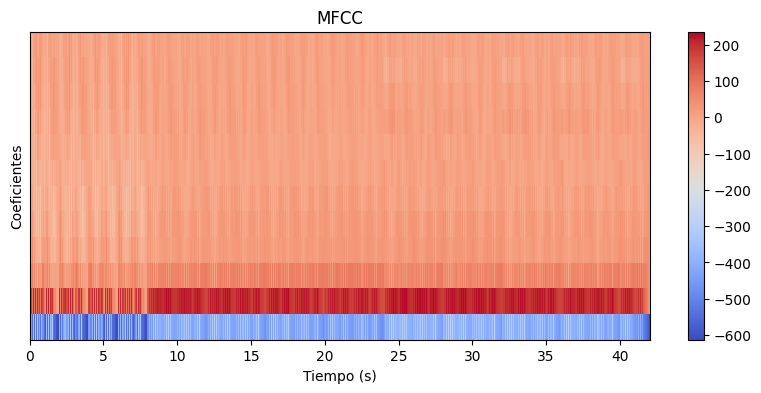

In [ ]:
# Cargar archivo
audio, sr = librosa.load(Ruta_base)

# Funcion para mfcc
mfccs = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=12)

# Plot MFCC
plt.figure(figsize=(10, 4))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')
plt.colorbar()
plt.title('MFCC')
plt.xlabel('Tiempo (s)')
plt.ylabel('Coeficientes')
plt.show()

C:\Users\lizar\AppData\Local\Temp\ipykernel_8460\894262018.py:1: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  spectrogram = librosa.amplitude_to_db(librosa.stft(audio), ref=np.max)


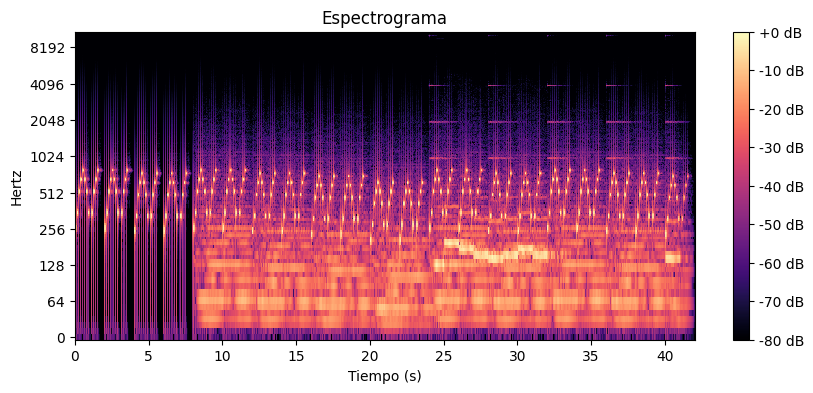

In [ ]:
#Funcion para espectrograma
spectrogram = librosa.amplitude_to_db(librosa.stft(audio), ref=np.max)

# Plot espectrograma
plt.figure(figsize=(10, 4))
librosa.display.specshow(spectrogram, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Espectrograma')
plt.xlabel('Tiempo (s)')
plt.ylabel('Hertz')
plt.show()

Libreria soundfile
Usada para separar el audio en bloques

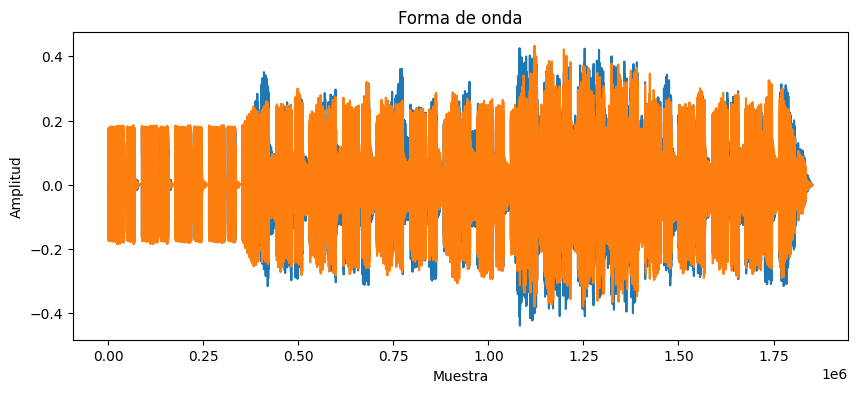

In [91]:

#SOUNDFILE

# Plot basico para Forma de onda 

audio, sr = sf.read(Ruta_base)

plt.figure(figsize=(10, 4))
plt.plot(audio)
plt.title('Forma de onda')
plt.xlabel('Muestra')
plt.ylabel('Amplitud')
plt.show()

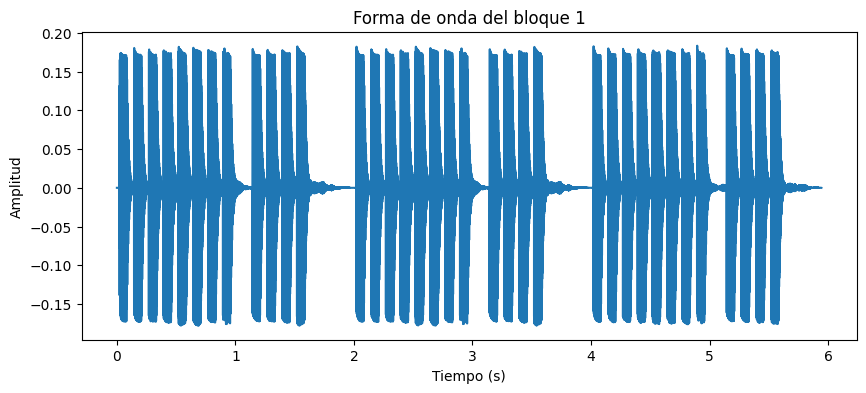

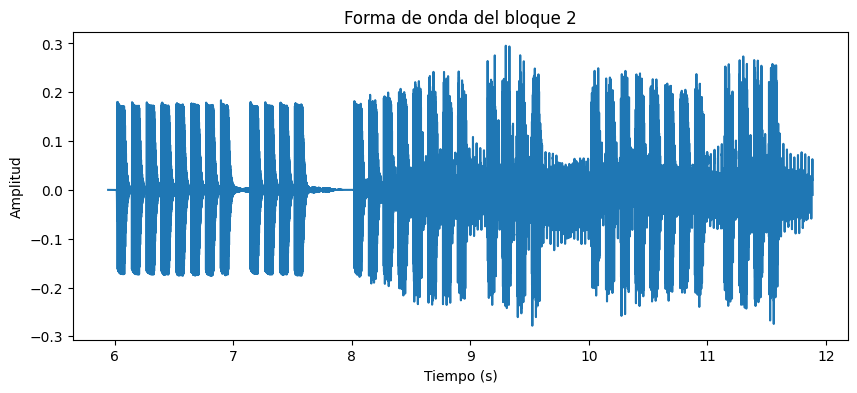

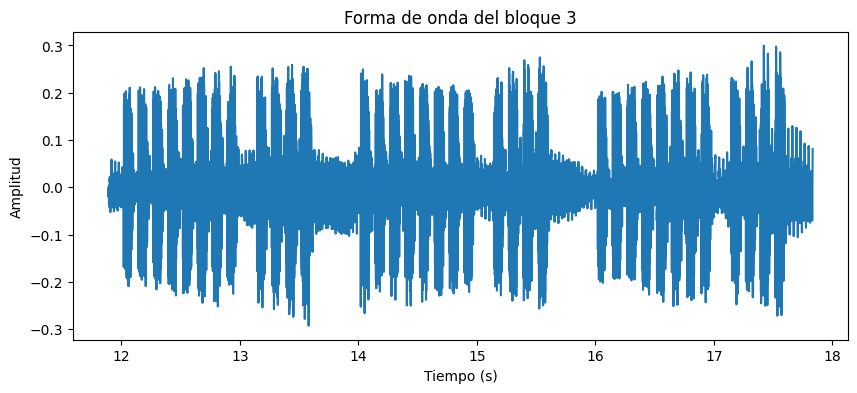

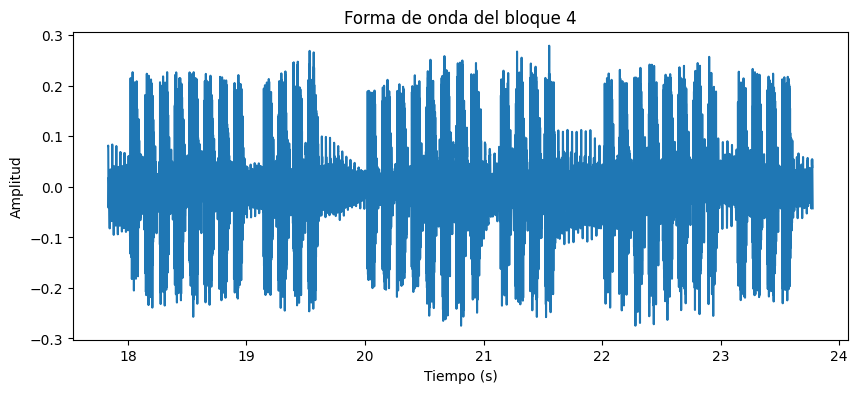

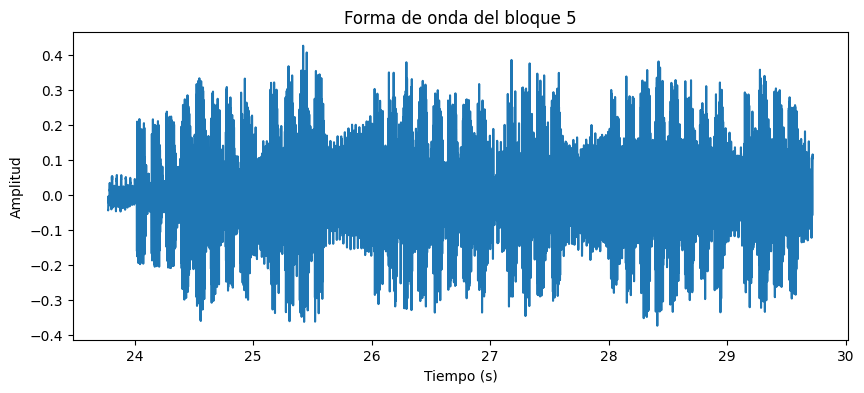

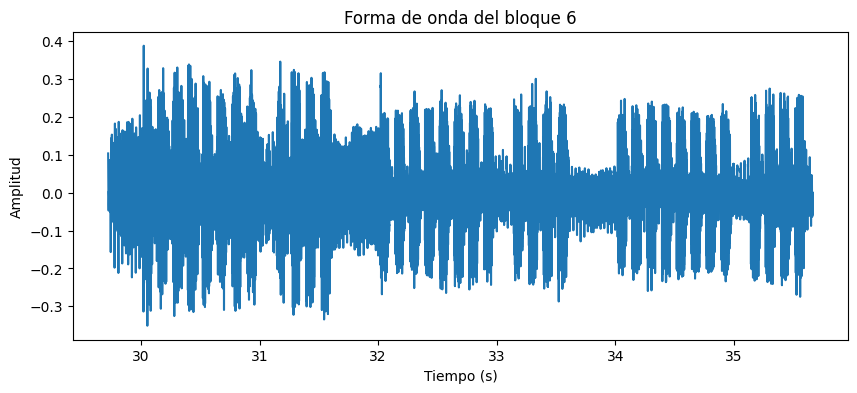

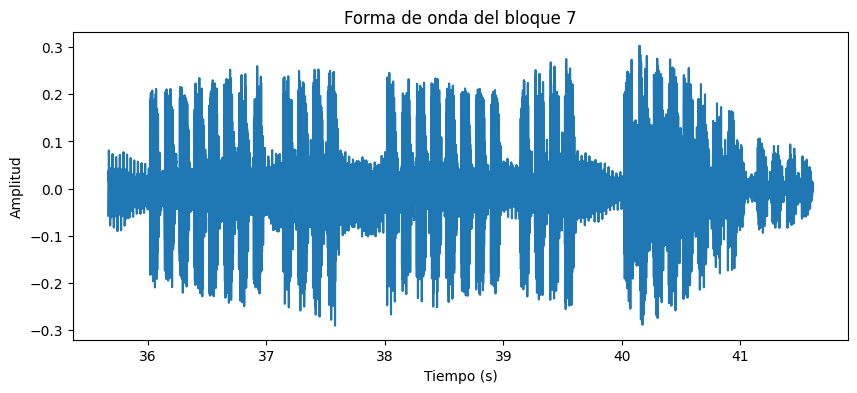

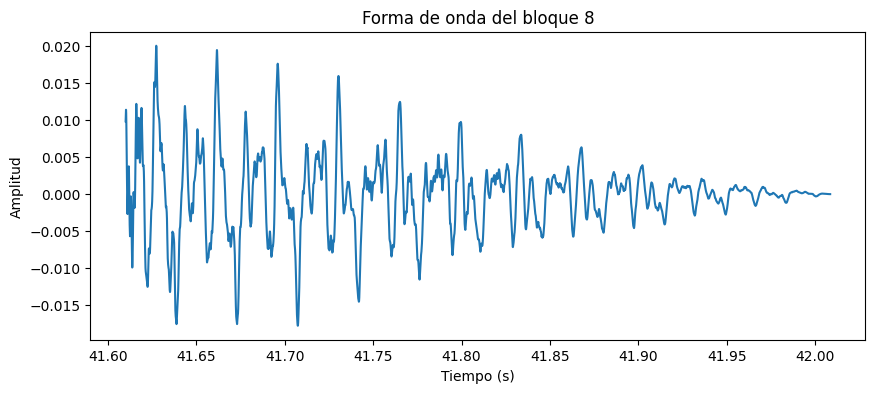

In [ ]:
# Funcion para separar muestras en bloques

block_size = 262144  #Cantidad de muestras modificable a conveniencia

# Abrir el archivo de audio
with sf.SoundFile(Ruta_base) as f:
    # Iterar sobre los bloques del archivo
    for i, block in enumerate(f.blocks(blocksize=block_size, dtype='float32')):
        # Promedio para convertir audio a mono
        if block.ndim == 2:
            block = block.mean(axis=1)

        # Calcular el número de muestras en el bloque
        num_samples = len(block)

        # Calcular el tiempo de cada muestra
        time = np.linspace(i * block_size / f.samplerate,
                           i * block_size / f.samplerate + num_samples / f.samplerate,
                           num=num_samples)

        # Visualizar la forma de onda del bloque
        plt.figure(figsize=(10, 4))
        plt.plot(time, block)
        plt.title(f'Forma de onda del bloque {i + 1}')
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Amplitud')
        plt.show()

Libreria WAVE
Usada para modificar la velocidad del audio y para extraer segmentos del audio

In [99]:
#Esta libreria solo soporta formato WAV

# Archivo WAV original
archivo_original = Ruta_base_wav

# Archivo WAV modificado
archivo_modificado = 'archivo_modificado.wav'

# Factor de velocidad
factor_velocidad = 1.5

# Cargar archivo wav en modo lectura ('rb')
with wave.open(archivo_original, 'rb') as wav_original:
    # Obtener parámetros
    params = wav_original.getparams()
    frames = wav_original.readframes(params.nframes)

# Crear el archivo WAV modificado en modo escritura ('wb')
with wave.open(archivo_modificado, 'wb') as wav_modificado:
    # Establecer los mismos parámetros que el archivo original
    wav_modificado.setparams(params)
    # Modificar la frecuencia de muestreo
    wav_modificado.setframerate(int(params.framerate * factor_velocidad))
    # Escribir los frames originales en el nuevo archivo
    wav_modificado.writeframes(frames)

display(Audio(Ruta_base_wav, autoplay=True))
display(Audio(r'C:\Users\lizar\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\Scripts\archivo_modificado.wav', autoplay=True))

In [61]:
# Funcion para extraer segmentos del audio

# Nuevo archivo con segmento extraido del audio
archivo_segmento = 'segmento_extraido.wav'

# Tiempo de inicio y duración del segmento
inicio_segundo = 10.0
duracion_segundo = 5.0  

with wave.open(archivo_original, 'rb') as wav_original:
    params = wav_original.getparams()
    framerate = wav_original.getframerate()
    # Calcular el frame de inicio y el número de frames
    inicio_frame = int(inicio_segundo * framerate)
    num_frames = int(duracion_segundo * framerate)
    # Posicionar el puntero en el frame de inicio
    wav_original.setpos(inicio_frame)
    # Leer los frames del segmento
    frames_segmento = wav_original.readframes(num_frames)

with wave.open(archivo_segmento, 'wb') as wav_segmento:
    wav_segmento.setparams(params)
    # Escribir los frames en el nuevo archivo
    wav_segmento.writeframes(frames_segmento)

display(Audio(r'C:\Users\lizar\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\Scripts\segmento_extraido.wav', autoplay=True))

Libreria pyaudio
Usadada para grabar audio, y en conjunto con libreria WAVE almacenar como archivo WAP

In [ ]:
# Parámetros de configuración
formato = pyaudio.paInt16  # Formato de audio (16 bits)
canales = 1                # Número de canales (mono)
frecuencia_muestreo = 44100  # Frecuencia de muestreo en Hz
duracion = 3               # Duración de la grabación en segundos
nombre_archivo = "grabacion.wav"  # Nombre del archivo de salida

# Inicializar PyAudio
audio = pyaudio.PyAudio()

# Iniciar la grabación
stream = audio.open(format=formato, channels=canales,
                    rate=frecuencia_muestreo, input=True,
                    frames_per_buffer=1024)

print("Grabando...")

frames = []

for _ in range(0, int(frecuencia_muestreo / 1024 * duracion)):
    data = stream.read(1024)
    frames.append(data)

# Detener la grabación
stream.stop_stream()
stream.close()
audio.terminate()

# Usamos libreria wave para guardar como audio WAV
with wave.open(nombre_archivo, 'wb') as archivo_wav:
    archivo_wav.setnchannels(canales)
    archivo_wav.setsampwidth(audio.get_sample_size(formato))
    archivo_wav.setframerate(frecuencia_muestreo)
    archivo_wav.writeframes(b''.join(frames))

display(Audio(r'C:\Users\lizar\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\Scripts\grabacion.wav', autoplay=True))


Grabando...


MUTAGEN / !pip install mutagen
Usada para modificar los metadatos de un archivo MP3

In [83]:
# Ruta al archivo MP3
archivo_mp3 = Ruta_base
# Cargar el archivo MP3
audio = MP3(archivo_mp3, ID3=ID3)
print(audio.tags)

{'TXXX:Encoded by': TXXX(encoding=<Encoding.LATIN1: 0>, desc='Encoded by', text=['LAME in FL Studio 20']), 'TXXX:BPM (beats per minute)': TXXX(encoding=<Encoding.LATIN1: 0>, desc='BPM (beats per minute)', text=['120']), 'TDRC': TDRC(encoding=<Encoding.LATIN1: 0>, text=['2018'])}


In [87]:
# Ruta al archivo MP3
archivo_mp3 = Ruta_base

# Cargar el archivo MP3
audio = MP3(archivo_mp3, ID3=ID3)

# Si el archivo no tiene etiquetas ID3, agregarlas
if audio.tags is None:
    audio.add_tags()

# Editar metadatos
audio.tags.add(TIT2(encoding=3, text='Sample'))
audio.tags.add(TPE1(encoding=3, text='Free samples'))
audio.tags.add(TALB(encoding=3, text='Álbum'))
audio.tags.add(TRCK(encoding=3, text='Número de pista'))

# Guardar los cambios
audio.save()# Ruta al archivo MP3
archivo_mp3 = r'C:\Users\lizar\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\Scripts\MP3-sample.mp3'

print(audio.tags)

{'TIT2': TIT2(encoding=<Encoding.UTF8: 3>, text=['Sample']), 'TPE1': TPE1(encoding=<Encoding.UTF8: 3>, text=['Free samples']), 'TRCK': TRCK(encoding=<Encoding.UTF8: 3>, text=['Número de pista']), 'TALB': TALB(encoding=<Encoding.UTF8: 3>, text=['Álbum']), 'TDRC': TDRC(encoding=<Encoding.LATIN1: 0>, text=['2018']), 'TXXX:BPM (beats per minute)': TXXX(encoding=<Encoding.LATIN1: 0>, desc='BPM (beats per minute)', text=['120']), 'TXXX:Encoded by': TXXX(encoding=<Encoding.LATIN1: 0>, desc='Encoded by', text=['LAME in FL Studio 20'])}
